In [1]:
#seperation of two codes

In [1]:
import os
import tensorflow as tf
from object_detection.utils import label_map_util
from object_detection.utils import visualization_utils as viz_utils
from object_detection.builders import model_builder
from object_detection.utils import config_util
import time

In [2]:
# Load pipeline config and build a detection model
configs = config_util.get_configs_from_pipeline_file("D:/models/research/object_detection/inference_graph/pipeline.config")
detection_model = model_builder.build(model_config=configs['model'], is_training=False)

# Restore checkpoint
ckpt = tf.compat.v2.train.Checkpoint(model=detection_model)
ckpt.restore(os.path.join("D:/models/research/object_detection/inference_graph/checkpoint", 'ckpt-0')).expect_partial()

@tf.function
def detect_fn(image):
    image, shapes = detection_model.preprocess(image)
    prediction_dict = detection_model.predict(image, shapes)
    detections = detection_model.postprocess(prediction_dict, shapes)
    return detections

In [3]:
import cv2 
import numpy as np
from matplotlib import pyplot as plt
%matplotlib inline

In [4]:
category_index = label_map_util.create_category_index_from_labelmap("D:/models/research/object_detection/labelmap.pbtxt", use_display_name=True)

In [5]:
IMAGE_PATH = os.path.join("D:/models/research/object_detection/dataset/train", 'IMG-20180108-WA0076_jpg.rf.d7e341ec78f95b1a254be329c83b29d7.jpg')


INFO:tensorflow:depth of additional conv before box predictor: 0
Instructions for updating:
Use ref() instead.
 Computational_time :  23.449800491333008


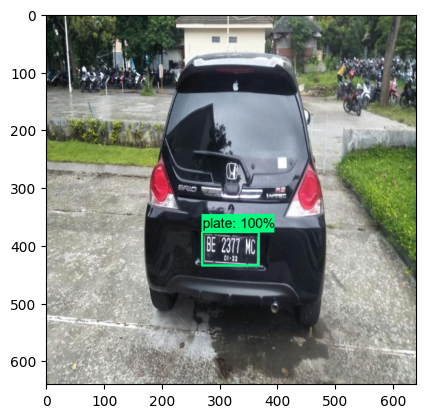

In [6]:
img = cv2.imread(IMAGE_PATH)
image_np = np.array(img)
start_time = time.time()

input_tensor = tf.convert_to_tensor(np.expand_dims(image_np, 0), dtype=tf.float32)
detections = detect_fn(input_tensor)

num_detections = int(detections.pop('num_detections'))
detections = {key: value[0, :num_detections].numpy()
              for key, value in detections.items()}
detections['num_detections'] = num_detections

# detection_classes should be ints.
detections['detection_classes'] = detections['detection_classes'].astype(np.int64)

label_id_offset = 1
image_np_with_detections = image_np.copy()

viz_utils.visualize_boxes_and_labels_on_image_array(
            image_np_with_detections,
            detections['detection_boxes'],
            detections['detection_classes']+label_id_offset,
            detections['detection_scores'],
            category_index,
            use_normalized_coordinates=True,
            max_boxes_to_draw=5,
            min_score_thresh=.8,
            agnostic_mode=False)


end_time = time.time()
computational_time = end_time - start_time
print(" Computational_time : ", computational_time)

plt.imshow(cv2.cvtColor(image_np_with_detections, cv2.COLOR_BGR2RGB))
plt.show()


In [7]:
import easyocr

In [8]:
detection_threshold = 0.7

In [9]:
image =image_np_with_detections
scores = list(filter(lambda x: x> detection_threshold, detections['detection_scores']))
boxes = detections['detection_boxes'][:len(scores)]
classes = detections['detection_classes'][:len(scores)]

In [10]:
width = image.shape[1]
height = image.shape[0]

CUDA not available - defaulting to CPU. Note: This module is much faster with a GPU.


[0.5898236 0.4215953 0.6794457 0.5756985]
[377.48710632 269.82099533 434.84523773 368.44703674]
[([[3, 3], [99, 3], [99, 43], [3, 43]], 'be 2377 HC', 0.414779568179426), ([[37, 39], [65, 39], [65, 53], [37, 53]], "0i'72", 0.04348706895672182)]


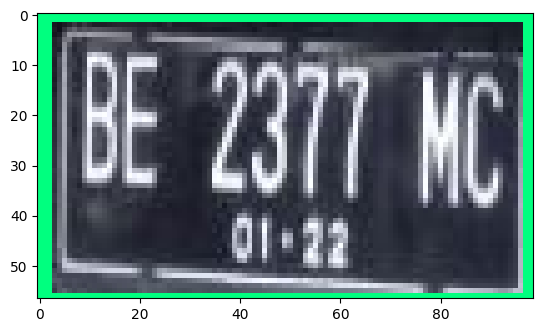

In [11]:
for idx, box in enumerate(boxes):
    print(box)
    roi = box*[height, width, height, width]
    print(roi)
    region = image[int(roi[0]):int(roi[2]),int(roi[1]):int(roi[3])]
    reader = easyocr.Reader(['en'])
    ocr_result = reader.readtext(region)
    print(ocr_result)
    plt.imshow(cv2.cvtColor(region, cv2.COLOR_BGR2RGB))

In [12]:
for result in ocr_result:
    print(result)


([[3, 3], [99, 3], [99, 43], [3, 43]], 'be 2377 HC', 0.414779568179426)
([[37, 39], [65, 39], [65, 53], [37, 53]], "0i'72", 0.04348706895672182)


In [13]:
region_threshold = 0.05

In [14]:
def filter_text(region, ocr_result, region_threshold):
    rectangle_size = region.shape[0]*region.shape[1]
    
    plate = [] 
    for result in ocr_result:
        length = np.sum(np.subtract(result[0][1], result[0][0]))
        height = np.sum(np.subtract(result[0][2], result[0][1]))
        
        if length*height / rectangle_size > region_threshold:
            plate.append(result[1])
    return plate

In [15]:
filter_text(region, ocr_result, region_threshold)


['be 2377 HC', "0i'72"]

In [16]:
region_threshold = 0.05

In [17]:
def ocr_it(image, detections, detection_threshold, region_threshold):
    
    # Scores, boxes and classes above threhold
    scores = list(filter(lambda x: x> detection_threshold, detections['detection_scores']))
    boxes = detections['detection_boxes'][:len(scores)]
    classes = detections['detection_classes'][:len(scores)]
    
    # Full image dimensions
    width = image.shape[1]
    height = image.shape[0]
    
    # Apply ROI filtering and OCR
    for idx, box in enumerate(boxes):
        roi = box*[height, width, height, width]
        region = image[int(roi[0]):int(roi[2]),int(roi[1]):int(roi[3])]
        reader = easyocr.Reader(['en'])
        ocr_result = reader.readtext(region)
        
        text = filter_text(region, ocr_result, region_threshold)
        
        plt.imshow(cv2.cvtColor(region, cv2.COLOR_BGR2RGB))
        plt.show()
        print(text)
        return text, region

CUDA not available - defaulting to CPU. Note: This module is much faster with a GPU.


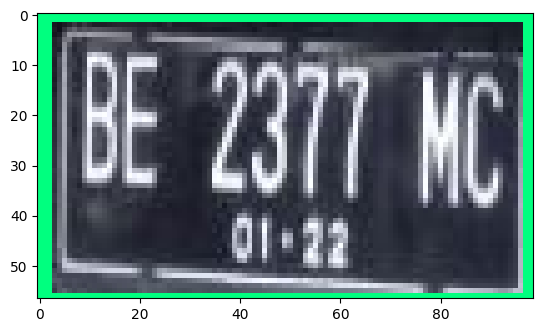

['be 2377 HC', "0i'72"]


In [18]:
text, region = ocr_it(image_np_with_detections, detections, detection_threshold, region_threshold)


In [19]:
import csv
import uuid

In [20]:
def save_results(text, region, csv_filename, folder_path):
    img_name = '{}.jpg'.format(uuid.uuid1())
    
    cv2.imwrite(os.path.join(folder_path, img_name), region)
    
    with open(csv_filename, mode='a', newline='') as f:
        csv_writer = csv.writer(f, delimiter=',', quotechar='"', quoting=csv.QUOTE_MINIMAL)
        csv_writer.writerow([img_name, text])

In [21]:
 #save_results(text, region, 'realtimeresults.csv', 'Detection_Images')

Computational Time:  0.25626659393310547
Computational Time:  0.2592904567718506
Computational Time:  0.2479112148284912
Computational Time:  0.25229549407958984
Computational Time:  0.2545785903930664
Computational Time:  0.25757908821105957
Computational Time:  0.2510337829589844
Computational Time:  0.2454366683959961
Computational Time:  0.24666929244995117


CUDA not available - defaulting to CPU. Note: This module is much faster with a GPU.


Computational Time:  0.245436429977417


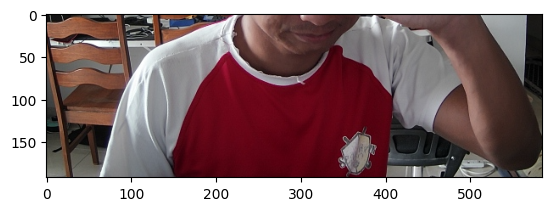

[]
Computational Time:  0.24405407905578613
Computational Time:  0.24715590476989746
Computational Time:  0.24548912048339844
Computational Time:  0.24906039237976074
Computational Time:  0.247298002243042


CUDA not available - defaulting to CPU. Note: This module is much faster with a GPU.


Computational Time:  0.2531909942626953


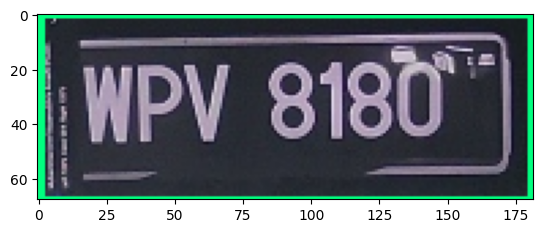

['WPV 8180']
Computational Time:  0.24757099151611328
Computational Time:  0.24557757377624512
Computational Time:  0.24662113189697266


CUDA not available - defaulting to CPU. Note: This module is much faster with a GPU.


Computational Time:  0.25094127655029297


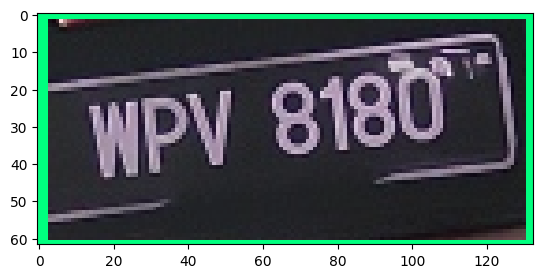

['WPV 8180']


CUDA not available - defaulting to CPU. Note: This module is much faster with a GPU.


Computational Time:  0.24900436401367188


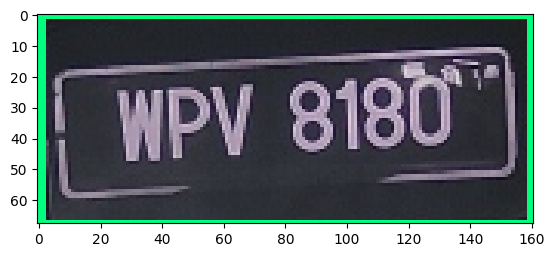

['WPV 8180']


CUDA not available - defaulting to CPU. Note: This module is much faster with a GPU.


Computational Time:  0.2506246566772461


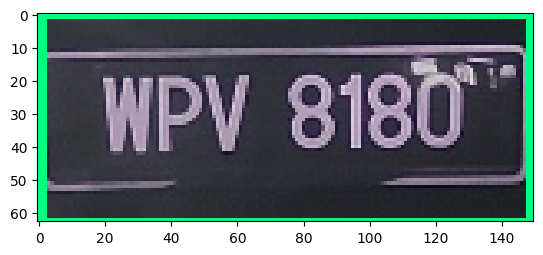

['WPV 8180']


CUDA not available - defaulting to CPU. Note: This module is much faster with a GPU.


Computational Time:  0.25166821479797363


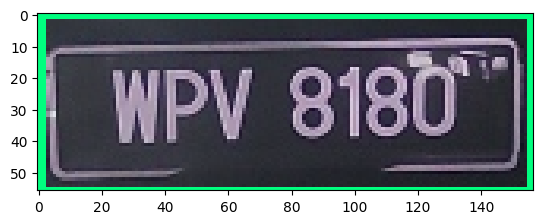

['WPV 8180']


In [25]:
cap = cv2.VideoCapture(0)
width = int(cap.get(cv2.CAP_PROP_FRAME_WIDTH))
height = int(cap.get(cv2.CAP_PROP_FRAME_HEIGHT))

while cap.isOpened(): 
    ret, frame = cap.read()
    image_np = np.array(frame)
    
    
    start_time = time.time()
    input_tensor = tf.convert_to_tensor(np.expand_dims(image_np, 0), dtype=tf.float32)
    detections = detect_fn(input_tensor)
    
    num_detections = int(detections.pop('num_detections'))
    detections = {key: value[0, :num_detections].numpy()
                  for key, value in detections.items()}
    detections['num_detections'] = num_detections

    # detection_classes should be ints.
    detections['detection_classes'] = detections['detection_classes'].astype(np.int64)

    label_id_offset = 1
    image_np_with_detections = image_np.copy()

    viz_utils.visualize_boxes_and_labels_on_image_array(
                image_np_with_detections,
                detections['detection_boxes'],
                detections['detection_classes']+label_id_offset,
                detections['detection_scores'],
                category_index,
                use_normalized_coordinates=True,
                max_boxes_to_draw=5,
                min_score_thresh=.8,
                agnostic_mode=False)
    end_time = time.time()
    computational_time = end_time - start_time
    print("Computational Time: ", computational_time)
    
    try: 
        text, region = ocr_it(image_np_with_detections, detections, detection_threshold, region_threshold)
        save_results(text, region, 'realtimeresults.csv', 'Detection_Images')
    except:
        pass

    cv2.imshow('object detection',  cv2.resize(image_np_with_detections, (800, 600)))
    
    if cv2.waitKey(10) & 0xFF == ord('q'):
        cap.release()
        cv2.destroyAllWindows()
        break

In [83]:
import io
import os
import scipy.misc
import numpy as np
import six
import time
import glob
from IPython.display import display

from six import BytesIO

import matplotlib
import matplotlib.pyplot as plt
from PIL import Image, ImageDraw, ImageFont

import tensorflow as tf
from object_detection.utils import ops as utils_ops
from object_detection.utils import label_map_util
from object_detection.utils import visualization_utils as vis_util

%matplotlib inline

In [84]:
def load_image_into_numpy_array(path):
  """Load an image from file into a numpy array.

  Puts image into numpy array to feed into tensorflow graph.
  Note that by convention we put it into a numpy array with shape
  (height, width, channels), where channels=3 for RGB.

  Args:
    path: a file path (this can be local or on colossus)

  Returns:
    uint8 numpy array with shape (img_height, img_width, 3)
  """
  img_data = tf.io.gfile.GFile(path, 'rb').read()
  image = Image.open(BytesIO(img_data))
  (im_width, im_height) = image.size
  return np.array(image.getdata()).reshape(
      (im_height, im_width, 3)).astype(np.uint8)

In [85]:
tf.keras.backend.clear_session()
model = tf.saved_model.load("D:/models/research/object_detection/inference_graph/saved_model")

In [86]:
def run_inference_for_single_image(model, image):
  image = np.asarray(image)
  # The input needs to be a tensor, convert it using `tf.convert_to_tensor`.
  input_tensor = tf.convert_to_tensor(image)
  # The model expects a batch of images, so add an axis with `tf.newaxis`.
  input_tensor = input_tensor[tf.newaxis,...]

  # Run inference
  model_fn = model.signatures['serving_default']
  output_dict = model_fn(input_tensor)

  # All outputs are batches tensors.
  # Convert to numpy arrays, and take index [0] to remove the batch dimension.
  # We're only interested in the first num_detections.
  num_detections = int(output_dict.pop('num_detections'))
  output_dict = {key:value[0, :num_detections].numpy() 
                 for key,value in output_dict.items()}
  output_dict['num_detections'] = num_detections

  # detection_classes should be ints.
  output_dict['detection_classes'] = output_dict['detection_classes'].astype(np.int64)
   
  # Handle models with masks:
  if 'detection_masks' in output_dict:
    # Reframe the the bbox mask to the image size.
    detection_masks_reframed = utils_ops.reframe_box_masks_to_image_masks(
              output_dict['detection_masks'], output_dict['detection_boxes'],
               image.shape[0], image.shape[1])      
    detection_masks_reframed = tf.cast(detection_masks_reframed > 0.5,
                                       tf.uint8)
    output_dict['detection_masks_reframed'] = detection_masks_reframed.numpy()
    
  return output_dict

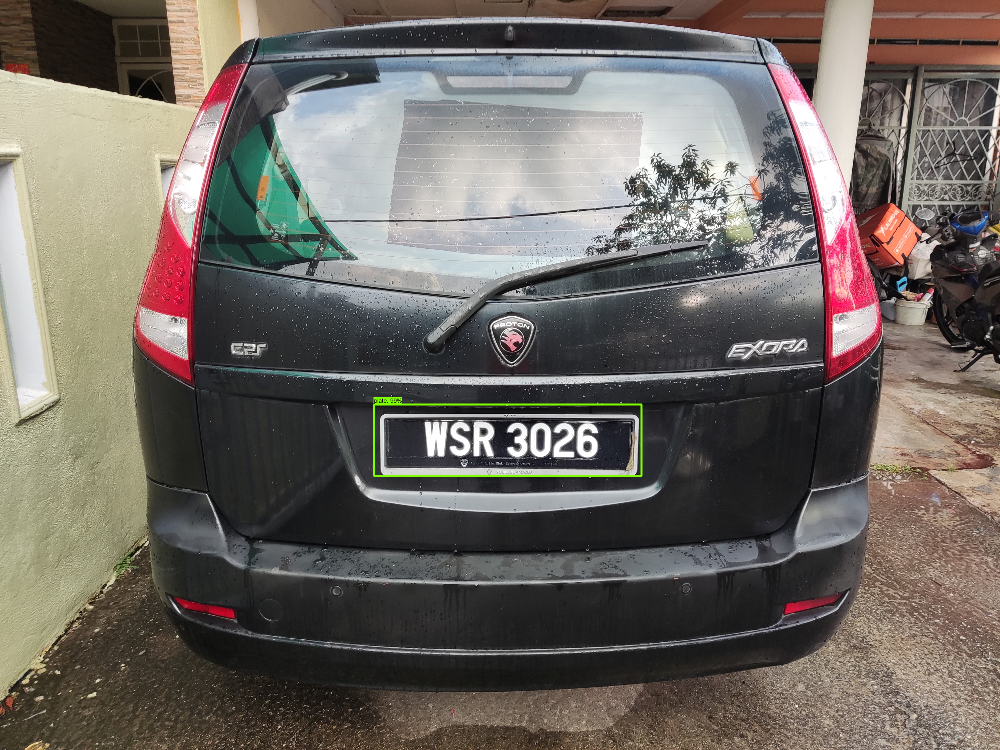

In [94]:
for image_path in glob.glob("D:/models/research/object_detection/test.jpg"):
  image_np = load_image_into_numpy_array(image_path)
  output_dict = run_inference_for_single_image(model, image_np)
  vis_util.visualize_boxes_and_labels_on_image_array(
      image_np,
      output_dict['detection_boxes'],
      output_dict['detection_classes'],
      output_dict['detection_scores'],
      category_index,
      instance_masks=output_dict.get('detection_masks_reframed', None),
      use_normalized_coordinates=True,
      line_thickness=8)
  display(Image.fromarray(image_np))